In [1]:
import pandas as pd
import numpy as np
import seaborn as sns; sns.set()
import matplotlib.pyplot as plt
import nltk
nltk.download('punkt')
from nltk import word_tokenize
from nltk import FreqDist
from nltk.stem import PorterStemmer
nltk.download('stopwords')
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))
porter = PorterStemmer()
from sklearn.feature_extraction.text import TfidfVectorizer

[nltk_data] Downloading package punkt to /Users/fafnir/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/fafnir/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [6]:
humanist_vols = pd.read_csv("web_scraped_humanist_listserv.csv")
humanist_vols.sample(5)

,dates,text
1,1988-1989,From: Sebastian Rahtz \nSubject: C++ and Gnu o...
29,vol29,Return-Path: \nX-Spam-Checker-Version: SpamAss...
25,vol25,From humanist-bounces@lists.digitalhumanities....
7,1994-1995,From: Andrew Burday \nSubject: Re: 7.0638 Qs: ...
17,2004-2005,From: Willard McCarty \nSubject: happy 17th bi...


In [8]:
humanist_vols['year_start'] = humanist_vols['dates'].str.split('-').str[0]
humanist_vols['year_end'] = humanist_vols['dates'].str.split('-').str[1]
humanist_vols['volume_size'] = humanist_vols['text'].str.count('\n')
humanist_vols = humanist_vols.iloc[:10, :]
humanist_vols

,dates,text,year_start,year_end,volume_size
0,1987-1988,From: MCCARTY@UTOREPAS\nSubject: \nDate: 12 Ma...,1987,1988,50794
1,1988-1989,From: Sebastian Rahtz \nSubject: C++ and Gnu o...,1988,1989,36109
2,1989-1990,From: Willard McCarty \nSubject: Happy Birthda...,1989,1990,108695
3,1990-1991,From: Elaine Brennan & Allen Renear \nSubject:...,1990,1991,118929
4,1991-1992,From: Elaine Brennan & Allen Renear \nSubject:...,1991,1992,81193
5,1992-1993,From: Elaine M Brennan \nSubject: Humanist's B...,1992,1993,59957
6,1993-1994,From: 6500card%ucsbuxa@hub.ucsb.edu (Cheryl A....,1993,1994,71763
7,1994-1995,From: Andrew Burday \nSubject: Re: 7.0638 Qs: ...,1994,1995,46569
8,1995-1996,"From: ""Gregory Bloomquist"" \nSubject: Round Ta...",1995,1996,61076
9,1996-1997,From: Humanist \nSubject: Humanist begins its ...,1996,1997,52506


Goal: Write code to identify the top ten unique words across the entire listserv dataset.

In [9]:
#subset_humanist_vols = humanist_vols[0:2]
def stem_words(row):
    stemmed_words = ''
    for token in row.split(' '):
        stemmed_words += porter.stem(token) + ' '
    return stemmed_words


humanist_vols['stemmed_text'] = humanist_vols.text.apply(stem_words)

from: mccarty@utorepas
subject: 
date: 12 may 1987, 23:50:02 edt
x-humanist: vol. 1 num. 1 (1)

thi is test number 1. pleas acknowledge.

from: mccarty@utorepas
subject: 
date: 13 may 1987, 00:06:41 edt
x-humanist: vol. 1 num. 2 (2)

thi is test number 2. pleas acknowledge.

from: mccarty@utorepas
subject: 
date: 13 may 1987, 23:08:57 edt
x-humanist: vol. 1 num. 3 (3)

thi is a test of a new bitnet mailer for peopl involv with the
support of comput in the humanities. pleas acknowledg receipt of
thi message. a more complet explan and welcom messag will be
forthcoming.
thank veri much.

from: ian@utorepas
subject: 
date: 14 may 1987, 16:05:17 edt
x-humanist: vol. 1 num. 4 (4)

messag received.

from: mccarty@utorepas
subject: 
date: 14 may 1987, 20:17:18 edt
x-humanist: vol. 1 num. 5 (5)

welcom to humanist
 
humanist is a bitnet/netnorth electron mail network for people
who support comput in the humanities. those who teach, review
software, answer questions, give advice, program, write


/var/folders/85/rf1k6_ks1k9gs93q1mmq3y_r0000gn/T/ipykernel_88362/3446309764.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  humanist_vols['stemmed_text'] = humanist_vols.text.apply(stem_words)


In [10]:
print(humanist_vols[0:1]['stemmed_text'].values)
# The stemmed words are somethings incomplete

['from: mccarty@utorepas\nsubject: \ndate: 12 may 1987, 23:50:02 edt\nx-humanist: vol. 1 num. 1 (1)\n\nthi is test number 1. pleas acknowledge.\n\nfrom: mccarty@utorepas\nsubject: \ndate: 13 may 1987, 00:06:41 edt\nx-humanist: vol. 1 num. 2 (2)\n\nthi is test number 2. pleas acknowledge.\n\nfrom: mccarty@utorepas\nsubject: \ndate: 13 may 1987, 23:08:57 edt\nx-humanist: vol. 1 num. 3 (3)\n\nthi is a test of a new bitnet mailer for peopl involv with the\nsupport of comput in the humanities. pleas acknowledg receipt of\nthi message. a more complet explan and welcom messag will be\nforthcoming.\nthank veri much.\n\nfrom: ian@utorepas\nsubject: \ndate: 14 may 1987, 16:05:17 edt\nx-humanist: vol. 1 num. 4 (4)\n\nmessag received.\n\nfrom: mccarty@utorepas\nsubject: \ndate: 14 may 1987, 20:17:18 edt\nx-humanist: vol. 1 num. 5 (5)\n\nwelcom to humanist\n \nhumanist is a bitnet/netnorth electron mail network for people\nwho support comput in the humanities. those who teach, review\nsoftware, ans

In [5]:
stemmed_column = []
for index, row, in humanist_vols.iterrows():
    stemmed_words = ''
    for token in row.text.split(' '):
        stemmed_words += porter.stem(token) + ' '
    stemmed_column.append(stemmed_words)

humanist_vols['stemmed_text'] = stemmed_column

In [11]:
def stem_words(row):
    stemmed_words = ''
    for token in row.text.split(' '):
        stemmed_words += porter.stem(token) + ' '
    return stemmed_words

humanist_vols['stemmed_text'] = humanist_vols.apply(stem_words, axis=1)

/var/folders/85/rf1k6_ks1k9gs93q1mmq3y_r0000gn/T/ipykernel_88362/1366240452.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  humanist_vols['stemmed_text'] = humanist_vols.apply(stem_words, axis=1)


In [12]:
documents = humanist_vols.text.tolist()
vectorizer = TfidfVectorizer(max_df=.7, min_df=1, stop_words=stop_words)


In [13]:
transformed_documents = vectorizer.fit_transform(documents)
transformed_documents_as_array = transformed_documents.toarray()
dates = humanist_vols.dates.tolist()
tfidf_results = []
for counter, doc in enumerate(transformed_documents_as_array):
    # construct a dataframe
    tf_idf_tuples = list(zip(vectorizer.get_feature_names(), doc))
    one_doc_as_df = pd.DataFrame.from_records(tf_idf_tuples, columns=[
                                              'term', 'score']).sort_values(by='score', ascending=False).reset_index(drop=True)
    one_doc_as_df['dates'] = dates[counter]
    tfidf_results.append(one_doc_as_df)


/Users/fafnir/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
/Users/fafnir/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
/Users/fafnir/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
/Users/fafnir/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarni

In [14]:
tfidf_df = pd.concat(tfidf_results)
tfidf_df = tfidf_df.sort_values(by=['score'], ascending=False)
tfidf_df = tfidf_df[(tfidf_df['term'] != '2002') & (tfidf_df['term'] != '2004') & (
    tfidf_df['term'] != '2006') & (tfidf_df['term'] != '2007') & (tfidf_df['term'] != '2008')]
tfidf_df.head(10)


,term,score,dates
0,utorepas,0.750031,1987-1988
0,http,0.600290,1996-1997
0,http,0.573855,1995-1996
1,www,0.509069,1995-1996
1,1997,0.488162,1996-1997
2,www,0.451835,1996-1997
0,gopher,0.390306,1993-1994
2,1996,0.386933,1995-1996
0,www,0.371210,1994-1995
3,html,0.362353,1995-1996


Goal: Write code to identify the top ten words that are distinctive of these two time periods(up to you to define the exact periodization).

In [15]:
tfidf_df['year_start'] = tfidf_df['dates'].str.split('-').str[0]
tfidf_df['year_end'] = tfidf_df['dates'].str.split('-').str[1]


In [16]:
tfidf_df['year_start'] = tfidf_df['year_start'].astype(int)
tfidf_df['year_end'] = tfidf_df['year_end'].astype(int)


In [17]:
before1990 = tfidf_df[tfidf_df['year_end'] < 1990]
after1990 = tfidf_df[tfidf_df['year_end'] > 1990]

In [18]:
before1990


,term,score,dates,year_start,year_end
0,utorepas,0.750031,1987-1988,1987,1988
0,astra,0.247443,1988-1989,1988,1989
1,na,0.186229,1988-1989,1988,1989
1,rahtz,0.161871,1987-1988,1987,1988
2,penndrls,0.131844,1988-1989,1988,1989
...,...,...,...,...,...
38605,velocities,0.000000,1987-1988,1987,1988
38604,velopment,0.000000,1987-1988,1987,1988
38603,veneris,0.000000,1987-1988,1987,1988
38602,venerunt,0.000000,1987-1988,1987,1988


In [19]:
after1990


,term,score,dates,year_start,year_end
0,http,0.600290,1996-1997,1996,1997
0,http,0.573855,1995-1996,1995,1996
1,www,0.509069,1995-1996,1995,1996
1,1997,0.488162,1996-1997,1996,1997
2,www,0.451835,1996-1997,1996,1997
...,...,...,...,...,...
93219,franaise,0.000000,1990-1991,1990,1991
93220,fran,0.000000,1990-1991,1990,1991
93221,framingham,0.000000,1990-1991,1990,1991
93222,framing,0.000000,1990-1991,1990,1991


Goal: The final step is to create a function that will take one of these terms and plot it’s frequency over time.


In [20]:
humanist_vols['count'] = humanist_vols['text'].str.lower(
).str.count('computer')
humanist_vols

/var/folders/85/rf1k6_ks1k9gs93q1mmq3y_r0000gn/T/ipykernel_88362/1599285327.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  humanist_vols['count'] = humanist_vols['text'].str.lower(


,dates,text,year_start,year_end,volume_size,stemmed_text,count
0,1987-1988,From: MCCARTY@UTOREPAS\nSubject: \nDate: 12 Ma...,1987,1988,50794,from: mccarty@utorepas\nsubject: \ndate: 12 ma...,1744
1,1988-1989,From: Sebastian Rahtz \nSubject: C++ and Gnu o...,1988,1989,36109,from: sebastian rahtz \nsubject: c++ and gnu o...,698
2,1989-1990,From: Willard McCarty \nSubject: Happy Birthda...,1989,1990,108695,from: willard mccarti \nsubject: happi birthda...,2975
3,1990-1991,From: Elaine Brennan & Allen Renear \nSubject:...,1990,1991,118929,from: elain brennan & allen renear \nsubject: ...,1880
4,1991-1992,From: Elaine Brennan & Allen Renear \nSubject:...,1991,1992,81193,from: elain brennan & allen renear \nsubject: ...,1295
5,1992-1993,From: Elaine M Brennan \nSubject: Humanist's B...,1992,1993,59957,from: elain m brennan \nsubject: humanist' bir...,966
6,1993-1994,From: 6500card%ucsbuxa@hub.ucsb.edu (Cheryl A....,1993,1994,71763,from: 6500card%ucsbuxa@hub.ucsb.edu (cheryl a....,1065
7,1994-1995,From: Andrew Burday \nSubject: Re: 7.0638 Qs: ...,1994,1995,46569,from: andrew burday \nsubject: re: 7.0638 qs: ...,625
8,1995-1996,"From: ""Gregory Bloomquist"" \nSubject: Round Ta...",1995,1996,61076,"from: ""gregori bloomquist"" \nsubject: round ta...",756
9,1996-1997,From: Humanist \nSubject: Humanist begins its ...,1996,1997,52506,from: humanist \nsubject: humanist begin it 10...,645


<AxesSubplot:xlabel='year_start'>

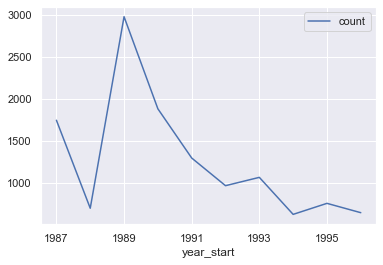

In [21]:
humanist_vols.plot(x='year_start', y='count', kind='line')


In [22]:
def textword(term):
    humanist_vols['count'] = humanist_vols['text'].str.lower().str.count(term)
    humanist_vols.plot(x='year_start', y='count', kind='line')

/var/folders/85/rf1k6_ks1k9gs93q1mmq3y_r0000gn/T/ipykernel_88362/1962900462.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  humanist_vols['count'] = humanist_vols['text'].str.lower().str.count(term)


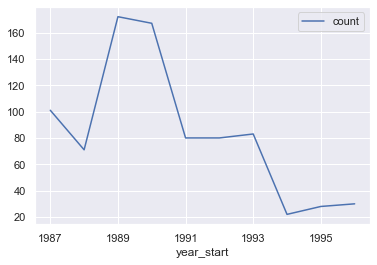

In [24]:
textword('joe')